## Data Loading

In [3]:
import pandas as pd
from datetime import datetime

# Load the dataset
file_path_new = '/run/media/viblab/Markov2/Haykal/AnakKrakatauEWSFinal/data/DEC_Results/Encoded_Forecasting_Dataset_NotNormalized.csv'  # Replace with your file path
data_new = pd.read_csv(file_path_new)

# Convert 'timestamp' to datetime
data_new['timestamp'] = pd.to_datetime(data_new['timestamp'])

# Ensure the data is sorted by timestamp
data_new.sort_values(by='timestamp', inplace=True)

# Identify timestamps where cluster == 2
eruption_times = data_new[data_new['cluster'] == 2]['timestamp']

# Initialize a column for time_to_eruption
data_new['time_to_eruption'] = float('nan')

# Calculate time to the next eruption in minutes for each row
for i, row in data_new.iterrows():
    # Find the next closest eruption time
    next_eruption = eruption_times[eruption_times >= row['timestamp']].min()
    if pd.notna(next_eruption):
        # Calculate the time difference in minutes
        time_diff = (next_eruption - row['timestamp']).total_seconds() / 60
        data_new.at[i, 'time_to_eruption'] = time_diff

# Display the first few rows of the updated dataset
data_new.head()


,timestamp,enc_0,enc_1,enc_2,enc_3,enc_4,enc_5,enc_6,enc_7,enc_8,...,enc_16,enc_17,enc_18,enc_19,enc_20,enc_21,enc_22,enc_23,cluster,time_to_eruption
0,2018-06-24 22:50:00+00:00,-1.0,320.94390,343.48047,84.15366,153.26033,-1.0,-0.035247,-1.0,401.537000,...,112.860870,245.50635,87.663910,-1.0,-1.0,86.175580,600.39465,77.588110,1,1301.0
1,2018-06-25 20:31:00+00:00,-1.0,297.38922,190.83397,117.01644,185.87040,-1.0,120.214250,-1.0,253.488680,...,337.649600,160.58463,14.388590,-1.0,-1.0,6.156882,511.90552,268.497220,2,0.0
2,2018-06-26 02:51:00+00:00,-1.0,267.76108,254.46250,96.81674,217.03769,-1.0,93.933830,-1.0,67.668304,...,303.285700,168.01591,-1.000000,-1.0,-1.0,-1.000000,496.22030,306.556640,1,4062.0
3,2018-06-26 02:59:00+00:00,-1.0,193.89575,171.22974,71.04069,150.89407,-1.0,52.019592,-1.0,127.788250,...,116.985435,122.09486,64.178795,-1.0,-1.0,43.668747,292.14390,92.881004,1,4054.0
4,2018-06-28 22:33:00+00:00,-1.0,466.30960,554.05286,474.08667,717.47595,-1.0,158.590760,-1.0,638.625300,...,392.806520,460.65700,-0.528935,-1.0,-1.0,129.166210,795.98816,-1.000000,2,0.0


In [4]:
# Filter the dataset for rows where time_to_eruption is between 10 and 1440 minutes
filtered_data = data_new[(data_new['time_to_eruption'] < 1080)]

start_datetime = pd.Timestamp('2018-06-24', tz='UTC')
end_datetime = pd.Timestamp('2018-12-22 01:23:00+00:00', tz='UTC')

# Filter the dataset based on the datetime range
filtered_by_datetime = filtered_data[(filtered_data['timestamp'] >= start_datetime) & (filtered_data['timestamp'] <= end_datetime)]


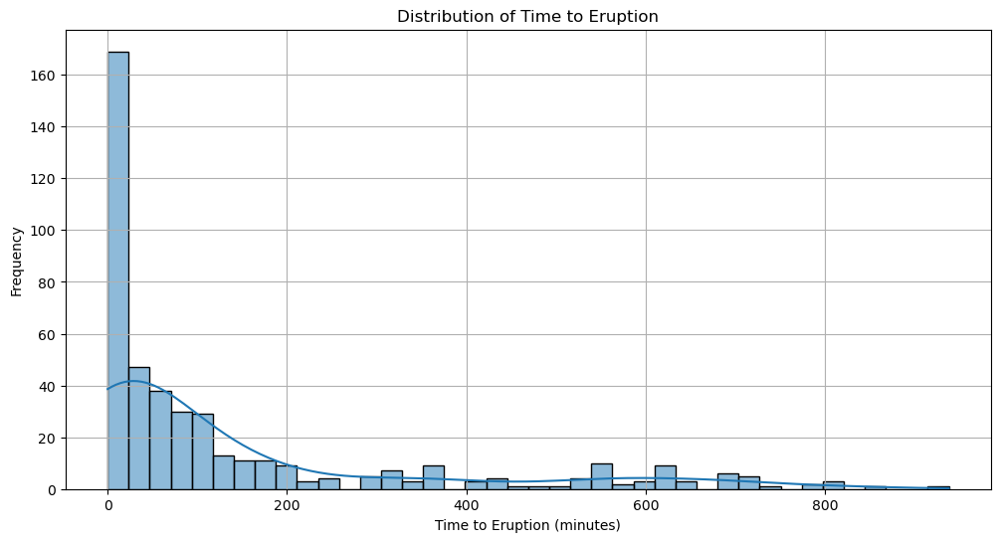

In [5]:
# Let's load the dataset to perform EDA and understand its distribution
import pandas as pd

# Load the dataset

data = filtered_by_datetime

# Performing EDA to understand the distribution of 'time to eruption'
eda_description = data['time_to_eruption'].describe()

# Determine the number of unique values
unique_counts = data['time_to_eruption'].nunique()

# Visualizing the distribution
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
sns.histplot(data['time_to_eruption'], bins=40, kde=True)
plt.title('Distribution of Time to Eruption')
plt.xlabel('Time to Eruption (minutes)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()


In [28]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

# Load the dataset
data = filtered_by_datetime

# If 'cluster' is not of type 'category', convert it
if data['cluster'].dtype != 'category':
    data['cluster'] = data['cluster'].astype('category')
    
# Selecting features
selected_features = ['enc_2','enc_3','enc_6','enc_8','enc_13','enc_14','enc_21','enc_23', 'cluster']  # Add/remove features as needed

X = data[selected_features]

# Target variable
y = data['time_to_eruption']


In [29]:
# Splitting the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


## XGBoost Regressor

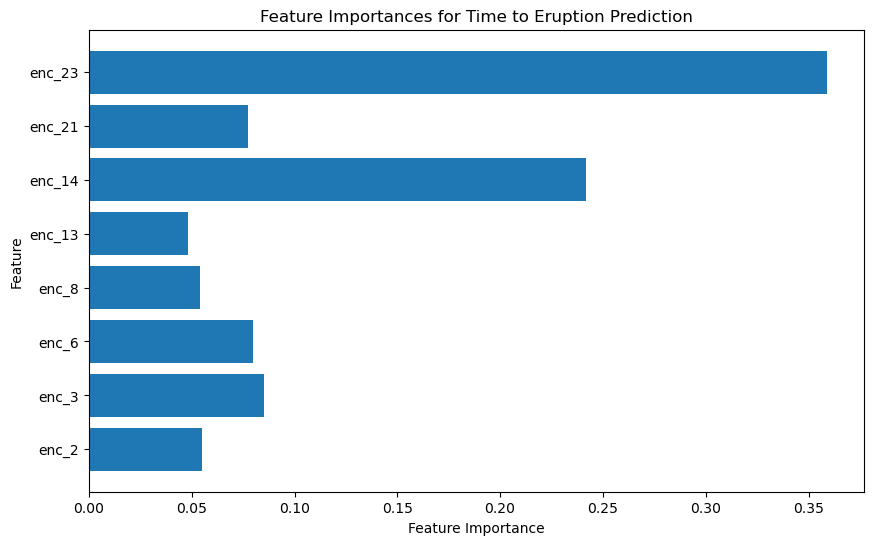

In [18]:
import xgboost as xgb

# Training the XGBoost model
xg_reg = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, learning_rate=0.05, max_depth=5)
xg_reg.fit(X_train, y_train)

# Feature importances
feature_importances = xg_reg.feature_importances_

# Plotting the feature importances
plt.figure(figsize=(10, 6))
plt.barh(selected_features, feature_importances)
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances for Time to Eruption Prediction')
plt.show()


In [23]:
import pandas as pd
import xgboost as xgb
from sklearn.model_selection import train_test_split, GridSearchCV


# Creating an instance of the XGBoost regressor
xg_reg = xgb.XGBRegressor(objective ='reg:squarederror')

# Parameter grid
param_grid = {
    'n_estimators': [50, 100, 150],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'max_depth': [3, 5, 7, 9],
    'min_child_weight': [1, 3, 5],
    'gamma': [0, 0.1, 0.2],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0],
    'lambda': [0.01, 0.1, 1],
    'alpha': [0, 5, 10]
}

# Creating the grid search
grid_search = GridSearchCV(estimator=xg_reg, param_grid=param_grid, 
                           cv=3, n_jobs=-1, verbose=2, scoring='neg_mean_absolute_error')

# Fitting the grid search
grid_search.fit(X_train, y_train)

# Best parameters
best_params = grid_search.best_params_
print("Best parameters:", best_params)

Fitting 3 folds for each of 34992 candidates, totalling 104976 fits
[CV] END alpha=0, colsample_bytree=0.6, gamma=0, lambda=0.01, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END alpha=0, colsample_bytree=0.6, gamma=0, lambda=0.01, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=50, subsample=0.8; total time=   0.1s
[CV] END alpha=0, colsample_bytree=0.6, gamma=0, lambda=0.01, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=50, subsample=0.6; total time=   0.1s
[CV] END alpha=0, colsample_bytree=0.6, gamma=0, lambda=0.01, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=50, subsample=0.6; total time=   0.1s
[CV] END alpha=0, colsample_bytree=0.6, gamma=0, lambda=0.01, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=50, subsample=0.8; total time=   0.1s
[CV] END alpha=0, colsample_bytree=0.6, gamma=0, lambda=0.01, learning_rate=0.01, max_depth=3, min_chi

In [28]:
from sklearn.metrics import mean_absolute_error, r2_score, mean_squared_error

# Training the model with the best parameters
best_xg_reg = xgb.XGBRegressor(objective='reg:squarederror', **best_params)
best_xg_reg.fit(X_train, y_train)

# Predicting on the test data
y_pred = best_xg_reg.predict(X_test)

# Calculating mean absolute error
mae = mean_absolute_error(y_test, y_pred)
print("Mean Absolute Error: ", mae)

# Calculating R-Squared
r2 = r2_score(y_test, y_pred)
print("R-squared: ", r2)

# Calculating Mean Squared Error
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error: ", mse)

Mean Absolute Error:  95.7227675265736
R-squared:  0.5178911173288474
Mean Squared Error:  22215.22162426661


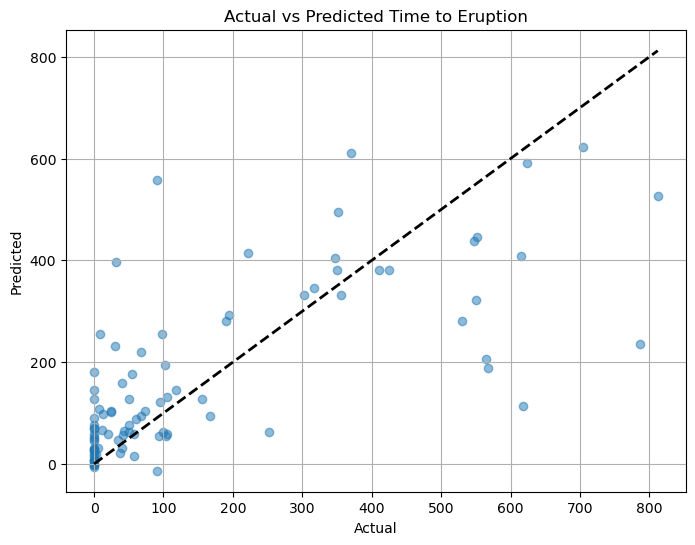

In [27]:
# Plotting actual vs predicted values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)  # Diagonal line
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted Time to Eruption')
plt.grid(True)
plt.show()

## LightGBM Regressor

##### SKLearn LGBMRegressor

In [12]:
import lightgbm as lgb
from sklearn.model_selection import train_test_split, GridSearchCV


# Creating a LightGBM regressor
lgb_reg = lgb.LGBMRegressor()

# Parameter grid
param_grid = {
    'num_leaves': [31, 50, 70],
    'learning_rate': [0.01, 0.05, 0.1],
    'n_estimators': [50, 100, 200],
    'max_depth': [3, 5, 7],
    'min_child_samples': [10, 20, 30],
    'subsample': [0.8, 1],
    'colsample_bytree': [0.8, 1],
    'reg_alpha': [0, 0.1, 1],
    'reg_lambda': [0, 0.1, 1],
}

# Creating the grid search
grid_search = GridSearchCV(estimator=lgb_reg, param_grid=param_grid, 
                           cv=3, n_jobs=-1, verbose=2, scoring='neg_mean_absolute_error')

# Fitting the grid search
grid_search.fit(X_train, y_train)

# Best parameters
best_params = grid_search.best_params_
print("Best parameters:", best_params)


Fitting 3 folds for each of 8748 candidates, totalling 26244 fits


[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=3, min_child_samples=10, n_estimators=50, num_leaves=31, reg_alpha=0, reg_lambda=0, subsample=0.8; total time=   0.0s
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=3, min_child_samples=10, n_estimators=50, num_leaves=31, reg_alpha=0, reg_lambda=1, subsample=1; total time=   0.0s
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=3, min_child_samples=10, n_estimators=50, num_leaves=31, reg_alpha=0, reg_lambda=0, subsample=1; total time=   0.0s
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=3, min_child_samples=10, n_estimators=50, num_leaves=31, reg_alpha=0, reg_lambda=1, subsample=1; total time=   0.0s
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=3, min_child_samples=10, n_estimators=50, num_leaves=31, reg_alpha=0.1, reg_lambda=0, subsample=0.8; total time=   0.0s
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=3, min_child_samples=10, n_estimators=50, num_le

In [ ]:
from sklearn.metrics import mean_absolute_error, r2_score, mean_squared_error

# Training the model with the best parameters
best_lgb_reg = lgb.LGBMRegressor(**best_params)
best_lgb_reg.fit(X_train, y_train)

# Predicting on the test data
y_pred = best_lgb_reg.predict(X_test)

# Calculating mean absolute error
mae = mean_absolute_error(y_test, y_pred)
print("Mean Absolute Error: ", mae)

# Calculating R-squared
r2 = r2_score(y_test, y_pred)
print("R-squared: ", r2)

# Calculating Mean Squared Error
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error: ", mse)

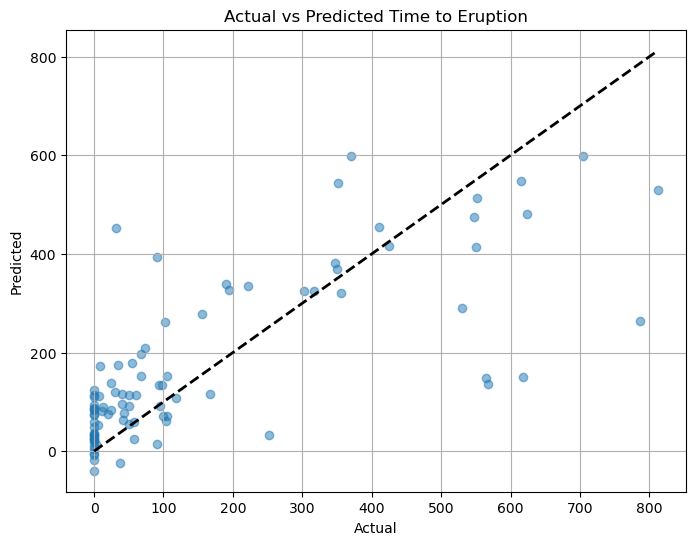

In [11]:
# Plotting actual vs predicted values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)  # Diagonal line
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted Time to Eruption')
plt.grid(True)
plt.show()

#### LGBM Regressor

Data Loading

In [59]:
import lightgbm as lgb
from sklearn.metrics import mean_absolute_error, r2_score, mean_squared_error

# Creating the LightGBM dataset
train_data = lgb.Dataset(X_train, label=y_train, categorical_feature=['cluster'], free_raw_data=False)
test_data = lgb.Dataset(X_test, label=y_test, categorical_feature=['cluster'], reference=train_data, free_raw_data=False)


Optuna Hyperparameter Tuning

In [60]:
import optuna
import lightgbm as lgb
from sklearn.metrics import mean_absolute_error

def objective(trial):
    # Define the hyperparameters to be tuned
    param = {
        'objective': 'regression',
        'metric': 'mae',
        'verbosity': -1,
        'boosting_type': 'gbdt',
        'num_leaves': trial.suggest_int('num_leaves', 20, 40),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.1),
        'n_estimators': trial.suggest_int('n_estimators', 20, 100),
        'max_depth': trial.suggest_int('max_depth', 3, 9),
        'min_child_samples': trial.suggest_int('min_child_samples', 5, 30),
        'subsample': trial.suggest_float('subsample', 0.7, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.7, 1.0),
        'reg_alpha': trial.suggest_float('reg_alpha', 0.0, 0.5),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.0, 0.5)
    }

    # Create a callback list with early stopping
    callbacks = [
        lgb.early_stopping(stopping_rounds=10)
    ]

    # Train a model with the current set of hyperparameters
    evals_result = {}
    model = lgb.train(param, train_data, valid_sets=[test_data], 
                      callbacks=callbacks, evals_result=evals_result, verbose_eval=False)

    # Predict on validation data
    y_pred = model.predict(X_test, num_iteration=model.best_iteration)

    # Compute the Mean Absolute Error
    mae = mean_absolute_error(y_test, y_pred)

    return mae

# Create a study object and optimize the objective function
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)

# Best hyperparameters
best_params = study.best_params
print("Best parameters:", best_params)

[I 2024-01-05 17:02:47,424] Trial 9 finished with value: 83.54556202539418 and parameters: {'num_leaves': 33, 'learning_rate': 0.08936413200684412, 'n_estimators': 66, 'max_depth': 9, 'min_child_samples': 16, 'subsample': 0.9233092710096412, 'colsample_bytree': 0.7683370074548889, 'reg_alpha': 0.10423989281270202, 'reg_lambda': 0.2318890269850421}. Best is trial 8 with value: 79.39526970678315.


Early stopping, best iteration is:
[42]	valid_0's l1: 83.5456
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[43]	valid_0's l1: 85.1206
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[78]	valid_0's l1: 81.0477
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[52]	valid_0's l1: 84.9197
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[66]	valid_0's l1: 85.0408
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[21]	valid_0's l1: 89.3358
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[56]	valid_0's l1: 82.0876
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[33]	valid_0's l1: 78.1591
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[52]	valid_0's l1: 81.8692


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
[LightGBM] [Fatal] Reducing `min_data_in_leaf` with `feature_pre_filter=true` may cause unexpected behaviour for features that were pre-filtered by the larger `min_data_in_leaf`.
You need to set `feature_pre_filter=false` to dynamically change the `min_data_in_leaf`.
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
[LightGBM] [Fatal] Reducing `min_data_in_leaf` with `feature_pre_filter=true` may cause unexpected behaviour for features that were pre-filtered by the larger `min_data_in_leaf`.
You need to set `feature_pre_filter=false` to dynamically change the `min_data_in_leaf`.
/home/viblab/.local/lib/python3.10/site-packages/lightgb

Training until validation scores don't improve for 10 rounds


[I 2024-01-05 17:03:28,506] Trial 18 finished with value: 81.02645945319985 and parameters: {'num_leaves': 40, 'learning_rate': 0.05872801864485091, 'n_estimators': 87, 'max_depth': 6, 'min_child_samples': 6, 'subsample': 0.8828145680971401, 'colsample_bytree': 0.9613656219251151, 'reg_alpha': 0.16992537571229152, 'reg_lambda': 0.27430494169791747}. Best is trial 16 with value: 78.15905590542633.


Early stopping, best iteration is:
[63]	valid_0's l1: 81.0265
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[39]	valid_0's l1: 80.5176
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[37]	valid_0's l1: 85.3222
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[45]	valid_0's l1: 80.8598


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds


[I 2024-01-05 17:03:50,436] Trial 22 finished with value: 83.87353020158852 and parameters: {'num_leaves': 35, 'learning_rate': 0.09325511352608111, 'n_estimators': 86, 'max_depth': 8, 'min_child_samples': 9, 'subsample': 0.7501941873896946, 'colsample_bytree': 0.9031016067954041, 'reg_alpha': 0.06752433807106056, 'reg_lambda': 0.10182943675947027}. Best is trial 16 with value: 78.15905590542633.


Early stopping, best iteration is:
[31]	valid_0's l1: 83.8735
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[38]	valid_0's l1: 83.5999


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
[LightGBM] [Fatal] Reducing `min_data_in_leaf` with `feature_pre_filter=true` may cause unexpected behaviour for features that were pre-filtered by the larger `min_data_in_leaf`.
You need to set `feature_pre_filter=false` to dynamically change the `min_data_in_leaf`.
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
[LightGBM] [Fatal] Reducing `min_data_in_leaf` with `feature_pre_filter=true` may cause unexpected behaviour for features that were pre-filtered by the larger `min_data_in_leaf`.
You need to set `feature_pre_filter=false` to dynamically change the `min_data_in_leaf`.
/home/viblab/.local/lib/python3.10/site-packages/lightgb

Training until validation scores don't improve for 10 rounds


[I 2024-01-05 17:04:05,340] Trial 24 finished with value: 85.06530714382691 and parameters: {'num_leaves': 34, 'learning_rate': 0.06440010456549232, 'n_estimators': 58, 'max_depth': 7, 'min_child_samples': 5, 'subsample': 0.8634801465064587, 'colsample_bytree': 0.9146762060050594, 'reg_alpha': 0.21576915579049868, 'reg_lambda': 0.2744129115597508}. Best is trial 16 with value: 78.15905590542633.


Early stopping, best iteration is:
[44]	valid_0's l1: 85.0653
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[32]	valid_0's l1: 84.4242
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[55]	valid_0's l1: 82.0227
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[83]	valid_0's l1: 83.6028
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[43]	valid_0's l1: 82.2096
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[37]	valid_0's l1: 80.3672
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[37]	valid_0's l1: 80.4858
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[25]	valid_0's l1: 86.6155
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[39]	valid_0's l1: 84.4937
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[33]	valid_0's l1: 86.7177
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[41]	valid_0's l1: 79.7348
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[29]	valid_0's l1: 85.6845
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[42]	valid_0's l1: 89.1579
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[46]	valid_0's l1: 82.6263
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[30]	valid_0's l1: 86.4054
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[41]	valid_0's l1: 93.3888
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[45]	valid_0's l1: 81.4205
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[37]	valid_0's l1: 80.0127
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[50]	valid_0's l1: 79.2292
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[47]	valid_0's l1: 83.2115
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[49]	valid_0's l1: 80.0418
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[61]	valid_0's l1: 80.6891
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[67]	valid_0's l1: 83.7807
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[39]	valid_0's l1: 81.5245
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[45]	valid_0's l1: 89.4439
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[33]	valid_0's l1: 81.6111
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[25]	valid_0's l1: 92.6293
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[45]	valid_0's l1: 80.981
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[50]	valid_0's l1: 80.8529
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[48]	valid_0's l1: 81.1941
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[33]	valid_0's l1: 81.3789
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[51]	valid_0's l1: 80.2808
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[44]	valid_0's l1: 81.8739
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[46]	valid_0's l1: 79.308
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[48]	valid_0's l1: 78.8635
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[50]	valid_0's l1: 81.9005
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[47]	valid_0's l1: 78.072
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[35]	valid_0's l1: 82.0393
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[38]	valid_0's l1: 83.0862
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[45]	valid_0's l1: 79.0626
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[49]	valid_0's l1: 80.9705
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[49]	valid_0's l1: 80.6201
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[49]	valid_0's l1: 83.7397
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[33]	valid_0's l1: 79.0337
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[39]	valid_0's l1: 82.0784
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[43]	valid_0's l1: 80.2293
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[34]	valid_0's l1: 82.718
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[48]	valid_0's l1: 78.5007
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[50]	valid_0's l1: 78.1579
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[44]	valid_0's l1: 79.1298
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[41]	valid_0's l1: 80.4434
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[65]	valid_0's l1: 82.4838
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[51]	valid_0's l1: 81.0582
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[44]	valid_0's l1: 80.8684
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[47]	valid_0's l1: 80.017
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[45]	valid_0's l1: 77.8388


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds


[I 2024-01-05 17:07:59,697] Trial 80 finished with value: 77.43161617126626 and parameters: {'num_leaves': 30, 'learning_rate': 0.08252721268762593, 'n_estimators': 66, 'max_depth': 7, 'min_child_samples': 7, 'subsample': 0.9496393658031903, 'colsample_bytree': 0.821969195705842, 'reg_alpha': 0.041513596853667636, 'reg_lambda': 0.33351933146405416}. Best is trial 80 with value: 77.43161617126626.


Early stopping, best iteration is:
[51]	valid_0's l1: 77.4316


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds


[I 2024-01-05 17:08:07,093] Trial 81 finished with value: 80.84518218291097 and parameters: {'num_leaves': 30, 'learning_rate': 0.08370604742128819, 'n_estimators': 73, 'max_depth': 7, 'min_child_samples': 8, 'subsample': 0.9534066941366408, 'colsample_bytree': 0.832106236538137, 'reg_alpha': 0.04576819817593404, 'reg_lambda': 0.35574587676737623}. Best is trial 80 with value: 77.43161617126626.


Early stopping, best iteration is:
[44]	valid_0's l1: 80.8452


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds


[I 2024-01-05 17:08:16,111] Trial 82 finished with value: 75.7112717994242 and parameters: {'num_leaves': 32, 'learning_rate': 0.08866365229099486, 'n_estimators': 79, 'max_depth': 7, 'min_child_samples': 7, 'subsample': 0.9823900626437787, 'colsample_bytree': 0.8062923742623292, 'reg_alpha': 0.05975803343887424, 'reg_lambda': 0.33070197135940743}. Best is trial 82 with value: 75.7112717994242.


Early stopping, best iteration is:
[57]	valid_0's l1: 75.7113


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds


[I 2024-01-05 17:08:28,267] Trial 83 finished with value: 82.68777147214097 and parameters: {'num_leaves': 31, 'learning_rate': 0.07845968221886415, 'n_estimators': 83, 'max_depth': 7, 'min_child_samples': 5, 'subsample': 0.9438722747240151, 'colsample_bytree': 0.8079738889136855, 'reg_alpha': 0.057218967854959384, 'reg_lambda': 0.32854603593106757}. Best is trial 82 with value: 75.7112717994242.


Early stopping, best iteration is:
[62]	valid_0's l1: 82.6878


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds


[I 2024-01-05 17:08:36,880] Trial 84 finished with value: 79.6884949976514 and parameters: {'num_leaves': 32, 'learning_rate': 0.09119918330311248, 'n_estimators': 74, 'max_depth': 7, 'min_child_samples': 7, 'subsample': 0.96252626303941, 'colsample_bytree': 0.7924112620954237, 'reg_alpha': 0.017175463087674377, 'reg_lambda': 0.2989398160541981}. Best is trial 82 with value: 75.7112717994242.


Early stopping, best iteration is:
[49]	valid_0's l1: 79.6885


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds


[I 2024-01-05 17:08:43,837] Trial 85 finished with value: 79.53809363288777 and parameters: {'num_leaves': 34, 'learning_rate': 0.08226942346007861, 'n_estimators': 78, 'max_depth': 7, 'min_child_samples': 7, 'subsample': 0.9803261231230919, 'colsample_bytree': 0.8285845377443, 'reg_alpha': 0.03584093181485107, 'reg_lambda': 0.33462558661967917}. Best is trial 82 with value: 75.7112717994242.


Early stopping, best iteration is:
[39]	valid_0's l1: 79.5381


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds


[I 2024-01-05 17:08:53,899] Trial 86 finished with value: 100.94144344627263 and parameters: {'num_leaves': 32, 'learning_rate': 0.016957618453808235, 'n_estimators': 66, 'max_depth': 7, 'min_child_samples': 6, 'subsample': 0.9717826149010258, 'colsample_bytree': 0.8208097344903343, 'reg_alpha': 0.06019085798481011, 'reg_lambda': 0.35564948661826945}. Best is trial 82 with value: 75.7112717994242.


Did not meet early stopping. Best iteration is:
[66]	valid_0's l1: 100.941
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[27]	valid_0's l1: 82.1823
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[36]	valid_0's l1: 80.3865


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds


[I 2024-01-05 17:09:09,726] Trial 89 finished with value: 82.26292140865783 and parameters: {'num_leaves': 31, 'learning_rate': 0.07541937637789069, 'n_estimators': 68, 'max_depth': 7, 'min_child_samples': 10, 'subsample': 0.9537612537258134, 'colsample_bytree': 0.7795906514847711, 'reg_alpha': 0.026789453237239563, 'reg_lambda': 0.2882162521320611}. Best is trial 82 with value: 75.7112717994242.


Early stopping, best iteration is:
[40]	valid_0's l1: 82.2629
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[50]	valid_0's l1: 78.2164
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[45]	valid_0's l1: 78.6648


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds


[I 2024-01-05 17:09:26,732] Trial 92 finished with value: 79.2661839348704 and parameters: {'num_leaves': 35, 'learning_rate': 0.08021041888724312, 'n_estimators': 96, 'max_depth': 6, 'min_child_samples': 8, 'subsample': 0.9465633753515444, 'colsample_bytree': 0.8391383181009734, 'reg_alpha': 0.0481406565827418, 'reg_lambda': 0.3103211493434426}. Best is trial 82 with value: 75.7112717994242.


Early stopping, best iteration is:
[58]	valid_0's l1: 79.2662
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[46]	valid_0's l1: 78.2784
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[44]	valid_0's l1: 78.0281
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[45]	valid_0's l1: 80.9755
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[57]	valid_0's l1: 79.5467


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds


[I 2024-01-05 17:09:53,098] Trial 97 finished with value: 81.73240100068003 and parameters: {'num_leaves': 31, 'learning_rate': 0.0873252633515081, 'n_estimators': 94, 'max_depth': 6, 'min_child_samples': 6, 'subsample': 0.9154496858300265, 'colsample_bytree': 0.8613749891884452, 'reg_alpha': 0.13958758955980619, 'reg_lambda': 0.3863553778028477}. Best is trial 82 with value: 75.7112717994242.


Early stopping, best iteration is:
[37]	valid_0's l1: 81.7324
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[61]	valid_0's l1: 81.1403
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[60]	valid_0's l1: 81.2985
Best parameters: {'num_leaves': 32, 'learning_rate': 0.08866365229099486, 'n_estimators': 79, 'max_depth': 7, 'min_child_samples': 7, 'subsample': 0.9823900626437787, 'colsample_bytree': 0.8062923742623292, 'reg_alpha': 0.05975803343887424, 'reg_lambda': 0.33070197135940743}


Training

In [61]:
# Train the final model using the best parameters

best_params['metric'] = 'mae'

evals_result = {}  # Dictionary to store evaluation results

# Create a callback list with early stopping
callbacks = [
    lgb.early_stopping(stopping_rounds=10),
    lgb.log_evaluation(period=1)
]

best_model = lgb.train(best_params, train_data, valid_sets=[train_data, test_data], 
                       valid_names=['training', 'validation'],
                       early_stopping_rounds=10, evals_result=evals_result)

# Predict with the best model
y_pred_best = best_model.predict(X_test, num_iteration=best_model.best_iteration)


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013659 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 958
[LightGBM] [Info] Number of data points in the train set: 358, number of used features: 9
[LightGBM] [Info] Start training from score 137.863128
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[1]	training's l1: 139.984	validation's l1: 154.027
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'cal

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[2]	training's l1: 132.064	validation's l1: 144.263
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[3]	training's l1: 124.574	validation's l1: 137.678
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[4]	training's l1: 117.824	validation's l1: 131.675
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[5]	training's l1: 111.78	validation's l1: 125.905
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[6]	training's l1: 106.203	validation's l1: 121.11
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[7]	training's l1: 101.191	validation's l1: 117.065
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[8]	training's l1: 96.6167	validation's l1: 113.539
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[9]	training's l1: 91.9584	validation'

In [65]:
# Calculate MAE
mae = mean_absolute_error(y_test, y_pred_best)
print(f"Best MAE: {mae}")

# Calculate RMSE
rmse = mean_squared_error(y_test, y_pred_best, squared=False)
print(f"Best RMSE: {rmse}")

# Calculate R^2
r2 = r2_score(y_test, y_pred_best)
print(f"Best R^2: {r2}")

Best MAE: 75.7112717994242
Best RMSE: 127.90629976447288
Best R^2: 0.6449591262867617


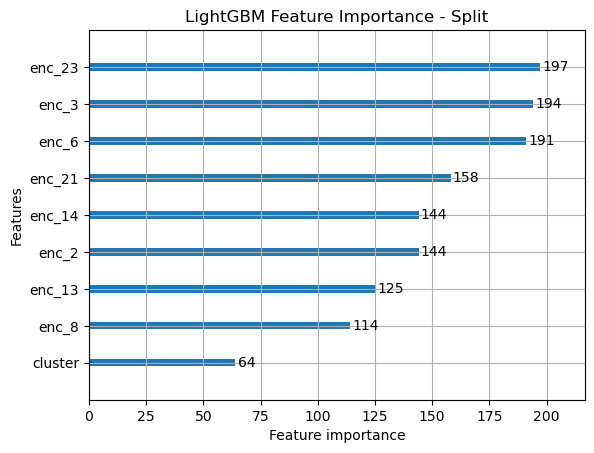

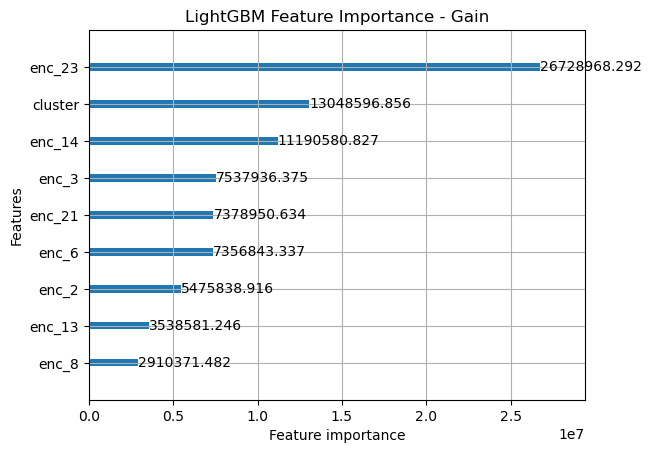

In [62]:
import matplotlib.pyplot as plt
import lightgbm as lgb

# Assuming best_model is your trained LightGBM model
lgb.plot_importance(best_model, importance_type='split')
plt.title("LightGBM Feature Importance - Split")
plt.show()

lgb.plot_importance(best_model, importance_type='gain')
plt.title("LightGBM Feature Importance - Gain")
plt.show()


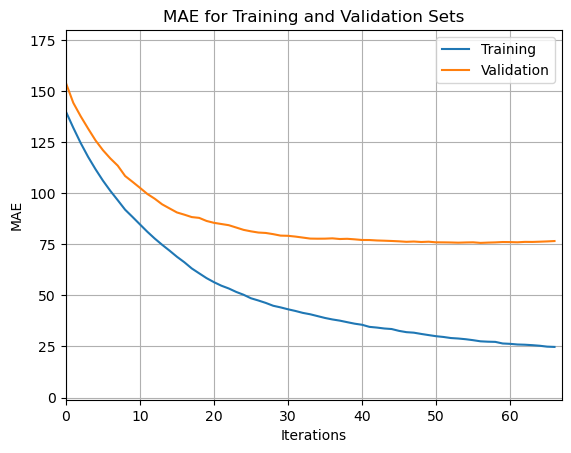

In [63]:
lgb.plot_metric(evals_result, metric='l1')
plt.title('MAE for Training and Validation Sets')
plt.xlabel('Iterations')
plt.ylabel('MAE')
plt.legend(['Training', 'Validation'])
plt.show()

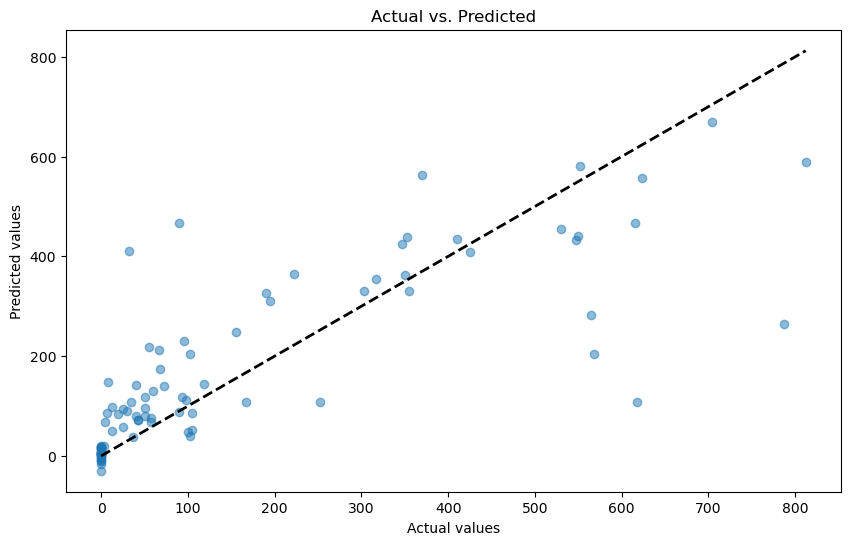

In [64]:
import matplotlib.pyplot as plt

# Assuming y_test are the actual values and y_pred_best are the predicted values from the model
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred_best, alpha=0.5)
plt.title('Actual vs. Predicted')
plt.xlabel('Actual values')
plt.ylabel('Predicted values')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)  # Diagonal line
plt.show()


# PCA Analysis

## Data Loading

In [10]:
import pandas as pd
from datetime import datetime

# Load the dataset
file_path_new = '/run/media/viblab/Markov2/Haykal/AnakKrakatauEWSFinal/data/DEC_Results/Encoded_Forecasting_Dataset_Normalized.csv'  # Replace with your file path
data_new = pd.read_csv(file_path_new)

# Convert 'timestamp' to datetime
data_new['timestamp'] = pd.to_datetime(data_new['timestamp'])

# Ensure the data is sorted by timestamp
data_new.sort_values(by='timestamp', inplace=True)

# Identify timestamps where cluster == 2
eruption_times = data_new[data_new['cluster'] == 2]['timestamp']

# Initialize a column for time_to_eruption
data_new['time_to_eruption'] = float('nan')

# Calculate time to the next eruption in minutes for each row
for i, row in data_new.iterrows():
    # Find the next closest eruption time
    next_eruption = eruption_times[eruption_times >= row['timestamp']].min()
    if pd.notna(next_eruption):
        # Calculate the time difference in minutes
        time_diff = (next_eruption - row['timestamp']).total_seconds() / 60
        data_new.at[i, 'time_to_eruption'] = time_diff

# Display the first few rows of the updated dataset
data_new.head()


,timestamp,enc_0,enc_1,enc_2,enc_3,enc_4,enc_5,enc_6,enc_7,enc_8,...,enc_16,enc_17,enc_18,enc_19,enc_20,enc_21,enc_22,enc_23,cluster,time_to_eruption
0,2018-06-24 22:50:00+00:00,0.0,0.153880,0.131726,0.020461,0.042775,0.0,0.000225,0.0,0.103674,...,0.031588,0.097323,2.227753e-02,0.0,0.0,0.014235,0.209731,0.013914,1,1301.0
1,2018-06-25 20:31:00+00:00,0.0,0.142621,0.073355,0.028357,0.051817,0.0,0.028261,0.0,0.065544,...,0.093951,0.063795,3.866509e-03,0.0,0.0,0.001169,0.178872,0.047715,2,0.0
2,2018-06-26 02:51:00+00:00,0.0,0.128460,0.097686,0.023503,0.060460,0.0,0.022133,0.0,0.017686,...,0.084417,0.066729,2.910383e-11,0.0,0.0,0.000000,0.173401,0.054453,1,4062.0
3,2018-06-26 02:59:00+00:00,0.0,0.093154,0.065859,0.017310,0.042119,0.0,0.012361,0.0,0.033170,...,0.032732,0.048599,1.637670e-02,0.0,0.0,0.007294,0.102231,0.016622,1,4054.0
4,2018-06-28 22:33:00+00:00,0.0,0.223360,0.212247,0.114154,0.199226,0.0,0.037208,0.0,0.164736,...,0.109253,0.182266,1.183589e-04,0.0,0.0,0.021254,0.277943,0.000000,2,0.0


In [11]:
# Filter the dataset for rows where time_to_eruption is between 10 and 1440 minutes
filtered_data = data_new[(data_new['time_to_eruption'] < 1080)]

start_datetime = pd.Timestamp('2018-06-24', tz='UTC')
end_datetime = pd.Timestamp('2018-12-22 01:23:00+00:00', tz='UTC')

# Filter the dataset based on the datetime range
filtered_by_datetime = filtered_data[(filtered_data['timestamp'] >= start_datetime) & (filtered_data['timestamp'] <= end_datetime)]


In [12]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

# Load the dataset
data = filtered_by_datetime

# If 'cluster' is not of type 'category', convert it
if data['cluster'].dtype != 'category':
    data['cluster'] = data['cluster'].astype('category')
    
# Selecting features
selected_features = ['enc_2','enc_3','enc_6','enc_8','enc_10','enc_13','enc_14','enc_16','enc_17','enc_18','enc_21','enc_22','enc_23', 'cluster']  # Add/remove features as needed


/tmp/ipykernel_1357562/2567642911.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['cluster'] = data['cluster'].astype('category')


PCA

In [13]:
from sklearn.decomposition import PCA

# Assuming 'selected_features' are all numerical features for PCA
# and that 'data' has been previously scaled
features_for_pca = [feature for feature in selected_features if feature.startswith('enc_')]

# Separating out the features for PCA
X_for_pca = data[features_for_pca]

# Initialize PCA, you can specify how many components you want, e.g., PCA(n_components=2)
pca = PCA(n_components=5)

# Fit and transform the data using PCA
principalComponents = pca.fit_transform(X_for_pca)

# Create a DataFrame with the principal components
principalDf = pd.DataFrame(data = principalComponents,
                           columns=['PC' + str(i) for i in range(1, pca.n_components_ + 1)])

# Check the explained variance ratio
explained_variance = pca.explained_variance_ratio_

# Display the explained variance
print("Explained Variance Ratios:", explained_variance)

# Concatenate the cluster column back to the DataFrame if needed
finalDf = pd.concat([principalDf, data['cluster'].reset_index(drop=True)], axis=1)


Explained Variance Ratios: [0.55008141 0.13500183 0.07981916 0.065067   0.04225374]


In [14]:
finalDf.head()

,PC1,PC2,PC3,PC4,PC5,cluster
0,-0.031622,-0.078518,-0.018653,0.022962,0.067903,2
1,0.235361,-0.047609,-0.063113,-0.069110,0.057981,2
2,0.034272,-0.088370,-0.005891,-0.018288,0.002121,1
3,-0.043825,-0.016341,-0.014487,0.007623,-0.013934,1
4,-0.126777,-0.027650,0.007734,0.017661,0.010682,1


In [15]:
import lightgbm as lgb
from sklearn.metrics import mean_absolute_error, r2_score, mean_squared_error

X = finalDf

# Target variable
y = data['time_to_eruption']

# Splitting the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Creating the LightGBM dataset
train_data = lgb.Dataset(X_train, label=y_train, categorical_feature=['cluster'], free_raw_data=False)
test_data = lgb.Dataset(X_test, label=y_test, categorical_feature=['cluster'], reference=train_data, free_raw_data=False)


Optuna Hyperparameter Tuning

In [16]:
import optuna
import lightgbm as lgb
from sklearn.metrics import mean_absolute_error

def objective(trial):
    # Define the hyperparameters to be tuned
    param = {
        'objective': 'regression',
        'metric': 'mae',
        'verbosity': -1,
        'boosting_type': 'gbdt',
        'num_leaves': trial.suggest_int('num_leaves', 20, 40),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.1),
        'n_estimators': trial.suggest_int('n_estimators', 20, 100),
        'max_depth': trial.suggest_int('max_depth', 3, 9),
        'min_child_samples': trial.suggest_int('min_child_samples', 5, 30),
        'subsample': trial.suggest_float('subsample', 0.7, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.7, 1.0),
        'reg_alpha': trial.suggest_float('reg_alpha', 0.0, 0.5),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.0, 0.5)
    }

    # Create a callback list with early stopping
    callbacks = [
        lgb.early_stopping(stopping_rounds=10)
    ]

    # Train a model with the current set of hyperparameters
    evals_result = {}
    model = lgb.train(param, train_data, valid_sets=[test_data], 
                      callbacks=callbacks, evals_result=evals_result, verbose_eval=False)

    # Predict on validation data
    y_pred = model.predict(X_test, num_iteration=model.best_iteration)

    # Compute the Mean Absolute Error
    mae = mean_absolute_error(y_test, y_pred)

    return mae

# Create a study object and optimize the objective function
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)

# Best hyperparameters
best_params = study.best_params
print("Best parameters:", best_params)

[I 2024-01-15 04:00:01,693] A new study created in memory with name: no-name-002993f4-458e-4ca7-a852-2463eeae6fd0
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated a

Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[58]	valid_0's l1: 77.3169
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[20]	valid_0's l1: 93.3735
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[23]	valid_0's l1: 120.938
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[46]	valid_0's l1: 122.673
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[20]	valid_0's l1: 132.223
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[36]	valid_0's l1: 82.2467


[I 2024-01-15 04:00:01,916] Trial 5 finished with value: 82.24670675216223 and parameters: {'num_leaves': 22, 'learning_rate': 0.05470661841765967, 'n_estimators': 36, 'max_depth': 6, 'min_child_samples': 16, 'subsample': 0.792243099504157, 'colsample_bytree': 0.9099903041938809, 'reg_alpha': 0.07389140338501193, 'reg_lambda': 0.045431825918122504}. Best is trial 0 with value: 77.31691902099851.
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evalua

Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[41]	valid_0's l1: 78.0078
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[58]	valid_0's l1: 78.2223
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[65]	valid_0's l1: 84.4984
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[56]	valid_0's l1: 87.8732
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[41]	valid_0's l1: 77.1921


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[35]	valid_0's l1: 78.4051
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l1: 79.2247
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[41]	valid_0's l1: 78.4321
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[65]	valid_0's l1: 79.1361


[I 2024-01-15 04:00:02,349] Trial 14 finished with value: 79.13613217925882 and parameters: {'num_leaves': 30, 'learning_rate': 0.05041605052106315, 'n_estimators': 82, 'max_depth': 4, 'min_child_samples': 25, 'subsample': 0.7930915199488244, 'colsample_bytree': 0.7973372501608305, 'reg_alpha': 0.3045047911392504, 'reg_lambda': 0.10674778952550223}. Best is trial 10 with value: 77.19205318909998.
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evalu

Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[52]	valid_0's l1: 76.8772
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[45]	valid_0's l1: 78.9989
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[43]	valid_0's l1: 80.8878
Training until validation scores don't improve for 10 rounds


[I 2024-01-15 04:00:02,618] Trial 18 finished with value: 78.64875152379634 and parameters: {'num_leaves': 37, 'learning_rate': 0.04396354823660434, 'n_estimators': 92, 'max_depth': 5, 'min_child_samples': 19, 'subsample': 0.8561289029803154, 'colsample_bytree': 0.7696337793315543, 'reg_alpha': 0.24278818346512582, 'reg_lambda': 0.2818732878607917}. Best is trial 15 with value: 76.87721563014186.
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evalu

Early stopping, best iteration is:
[71]	valid_0's l1: 78.6488
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[52]	valid_0's l1: 79.4493
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[32]	valid_0's l1: 81.9218
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[56]	valid_0's l1: 78.442
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[41]	valid_0's l1: 79.2101
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[35]	valid_0's l1: 78.432
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[37]	valid_0's l1: 78.9802


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[50]	valid_0's l1: 84.1719
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[48]	valid_0's l1: 77.7202
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[67]	valid_0's l1: 78.8087


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[43]	valid_0's l1: 75.2268
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[33]	valid_0's l1: 79.4356
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[35]	valid_0's l1: 79.2088


[I 2024-01-15 04:00:03,481] Trial 30 finished with value: 79.20877683153869 and parameters: {'num_leaves': 29, 'learning_rate': 0.08593930224275065, 'n_estimators': 37, 'max_depth': 3, 'min_child_samples': 15, 'subsample': 0.9973489679422176, 'colsample_bytree': 0.868126192536002, 'reg_alpha': 0.07701020905671035, 'reg_lambda': 0.39301673334284937}. Best is trial 28 with value: 75.22678997961712.
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evalu

Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[38]	valid_0's l1: 79.2436
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[43]	valid_0's l1: 79.1112
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[26]	valid_0's l1: 86.917
Training until validation scores don't improve for 10 rounds


[I 2024-01-15 04:00:03,738] Trial 34 finished with value: 79.14541832238272 and parameters: {'num_leaves': 38, 'learning_rate': 0.06848997065886941, 'n_estimators': 51, 'max_depth': 7, 'min_child_samples': 17, 'subsample': 0.7760589993537936, 'colsample_bytree': 0.7744979476277413, 'reg_alpha': 0.354085430154428, 'reg_lambda': 0.1038428408922831}. Best is trial 28 with value: 75.22678997961712.
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluat

Did not meet early stopping. Best iteration is:
[42]	valid_0's l1: 79.1454
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[31]	valid_0's l1: 79.5522
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[35]	valid_0's l1: 76.4682
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[37]	valid_0's l1: 78.428


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[33]	valid_0's l1: 75.0689
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[34]	valid_0's l1: 76.567
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[34]	valid_0's l1: 76.811


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[36]	valid_0's l1: 77.0616
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[27]	valid_0's l1: 80.0984


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[41]	valid_0's l1: 75.122
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[45]	valid_0's l1: 79.9474
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[26]	valid_0's l1: 81.2353


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[33]	valid_0's l1: 76.8367
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l1: 79.5391
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[46]	valid_0's l1: 79.5843
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[40]	valid_0's l1: 80.2075
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[21]	valid_0's l1: 84.3463
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[40]	valid_0's l1: 80.0135


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[36]	valid_0's l1: 77.189
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[30]	valid_0's l1: 76.9651
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[32]	valid_0's l1: 81.1023


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[53]	valid_0's l1: 101.422
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[26]	valid_0's l1: 86.9712
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l1: 77.9616


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[31]	valid_0's l1: 79.5212
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[31]	valid_0's l1: 77.1263
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[26]	valid_0's l1: 78.5742


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[30]	valid_0's l1: 77.9781
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l1: 81.0446
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[40]	valid_0's l1: 72.4976


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[35]	valid_0's l1: 76.4574
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[39]	valid_0's l1: 76.0135
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l1: 76.0124


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[38]	valid_0's l1: 75.4906
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[40]	valid_0's l1: 76.7732
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[41]	valid_0's l1: 77.0067
Training until validation scores don't improve for 10 rounds


[I 2024-01-15 04:00:06,504] Trial 70 finished with value: 78.33132573871939 and parameters: {'num_leaves': 20, 'learning_rate': 0.07193096870006083, 'n_estimators': 53, 'max_depth': 3, 'min_child_samples': 15, 'subsample': 0.8557751475435514, 'colsample_bytree': 0.975868224118901, 'reg_alpha': 0.30580690165013397, 'reg_lambda': 0.27479106862750213}. Best is trial 63 with value: 72.49757407747224.
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evalu

Did not meet early stopping. Best iteration is:
[49]	valid_0's l1: 78.3313
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[44]	valid_0's l1: 75.3621
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[39]	valid_0's l1: 78.5657
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[44]	valid_0's l1: 77.1232
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[56]	valid_0's l1: 81.5784


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds


[I 2024-01-15 04:00:07,466] Trial 75 finished with value: 74.68410853989738 and parameters: {'num_leaves': 22, 'learning_rate': 0.08554099777616121, 'n_estimators': 66, 'max_depth': 4, 'min_child_samples': 15, 'subsample': 0.8159469367333765, 'colsample_bytree': 0.9740239593088609, 'reg_alpha': 0.0024777245290125705, 'reg_lambda': 0.2515575457974157}. Best is trial 63 with value: 72.49757407747224.
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_eva

Did not meet early stopping. Best iteration is:
[59]	valid_0's l1: 74.6841
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[36]	valid_0's l1: 79.3172
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[30]	valid_0's l1: 76.1106
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Did not meet early stopping. Best iteration is:
[57]	valid_0's l1: 75.7785
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[59]	valid_0's l1: 77.2145
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[55]	valid_0's l1: 77.3924
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[45]	valid_0's l1: 74.9784
Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[53]	valid_0's l1: 78.8613
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[49]	valid_0's l1: 78.8834
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[42]	valid_0's l1: 74.5609
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[45]	valid_0's l1: 73.8184
Training until validation scores don't improve for 10 rounds


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Early stopping, best iteration is:
[38]	valid_0's l1: 75.556
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l1: 75.6874
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[31]	valid_0's l1: 77.323
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[33]	valid_0's l1: 80.23


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[30]	valid_0's l1: 76.6886
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[43]	valid_0's l1: 75.1989
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[37]	valid_0's l1: 76.5176


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Did not meet early stopping. Best iteration is:
[81]	valid_0's l1: 76.6675
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[47]	valid_0's l1: 74.6579
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[33]	valid_0's l1: 80.1758


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[45]	valid_0's l1: 76.2754
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[31]	valid_0's l1: 78.3477
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l1: 74.2711


/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument i

Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l1: 77.3504
Best parameters: {'num_leaves': 23, 'learning_rate': 0.08402684174507255, 'n_estimators': 43, 'max_depth': 5, 'min_child_samples': 16, 'subsample': 0.7200095426487082, 'colsample_bytree': 0.9986339152201417, 'reg_alpha': 0.0006638413554958811, 'reg_lambda': 0.42168893080626785}


Training

In [17]:
# Train the final model using the best parameters

best_params['metric'] = 'mae'

evals_result = {}  # Dictionary to store evaluation results

# Create a callback list with early stopping
callbacks = [
    lgb.early_stopping(stopping_rounds=10),
    lgb.log_evaluation(period=1)
]

best_model = lgb.train(best_params, train_data, valid_sets=[train_data, test_data], 
                       valid_names=['training', 'validation'],
                       early_stopping_rounds=10, evals_result=evals_result)

# Predict with the best model
y_pred_best = best_model.predict(X_test, num_iteration=best_model.best_iteration)


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 606
[LightGBM] [Info] Number of data points in the train set: 358, number of used features: 6
[LightGBM] [Info] Start training from score 137.863128
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[1]	training's l1: 143.175	validation's l1: 154.671
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[2]	training's l1: 137.422	validation's l1: 145.594
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[3]	training's l1: 131.764	validation's l1: 138.057
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[4]	training's l1: 127.113	validation's l1: 131.607
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[5]	training'

/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
/home/viblab/.local/lib/python3.10/site-packages/lightgbm/engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'cal

In [18]:
# Calculate MAE
mae = mean_absolute_error(y_test, y_pred_best)
print(f"Best MAE: {mae}")

# Calculate RMSE
rmse = mean_squared_error(y_test, y_pred_best, squared=False)
print(f"Best RMSE: {rmse}")

# Calculate R^2
r2 = r2_score(y_test, y_pred_best)
print(f"Best R^2: {r2}")

Best MAE: 73.24968794307578
Best RMSE: 106.34232335934024
Best R^2: 0.7545817968411668


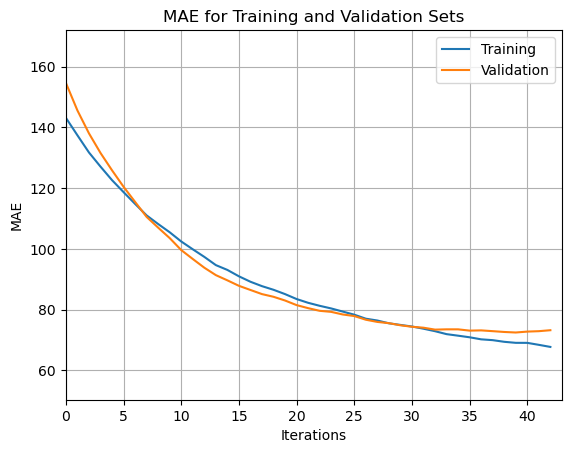

In [19]:
import matplotlib.pyplot as plt

lgb.plot_metric(evals_result, metric='l1')
plt.title('MAE for Training and Validation Sets')
plt.xlabel('Iterations')
plt.ylabel('MAE')
plt.legend(['Training', 'Validation'])
plt.show()

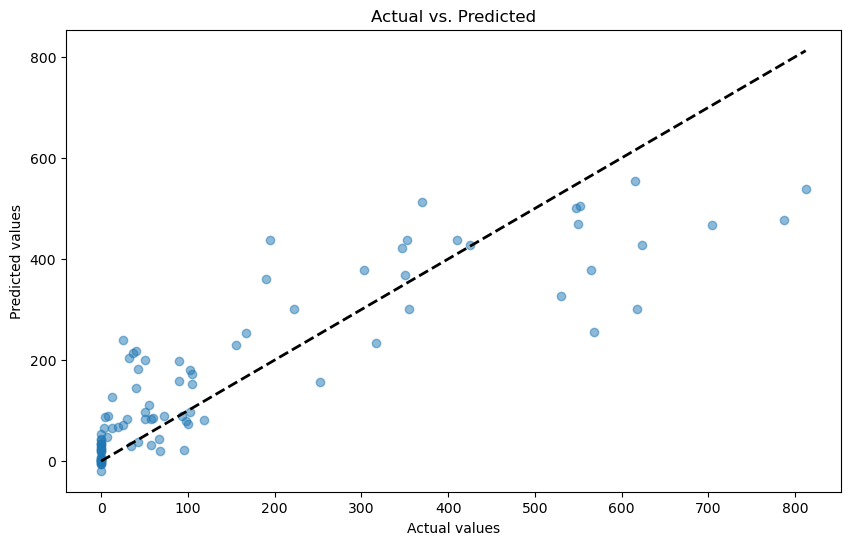

In [20]:
import matplotlib.pyplot as plt

# Assuming y_test are the actual values and y_pred_best are the predicted values from the model
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred_best, alpha=0.5)
plt.title('Actual vs. Predicted')
plt.xlabel('Actual values')
plt.ylabel('Predicted values')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)  # Diagonal line
plt.show()


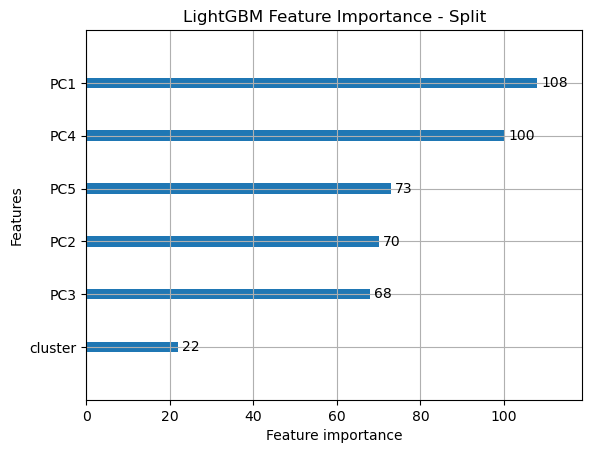

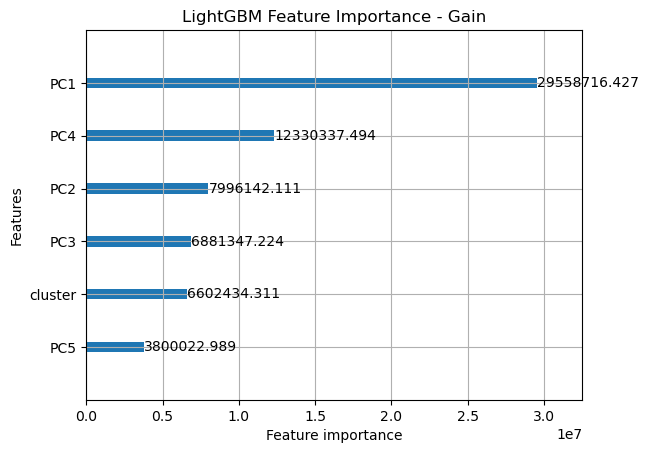

In [21]:
import matplotlib.pyplot as plt
import lightgbm as lgb

# Assuming best_model is your trained LightGBM model
lgb.plot_importance(best_model, importance_type='split')
plt.title("LightGBM Feature Importance - Split")
plt.show()

lgb.plot_importance(best_model, importance_type='gain')
plt.title("LightGBM Feature Importance - Gain")
plt.show()
